# Fingerprint-based similarity scores - percentile scaling for better comparison

Different fingerprints lead to strongly differing molecular similarity scores. To better compare them, we convert the individual scores to percentiles.

## Data

Here we use the **ms2structures dataset** containing 37,811 unique compounds.

In [ ]:
import os
import sys
from pathlib import Path
import random
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm

from rdkit.Chem import rdFingerprintGenerator

ROOT = Path(os.getcwd()).parents[0]
path_data = os.path.join(Path(ROOT), "data")

In [2]:
filename = "compounds_ms2structures.csv"
compounds = pd.read_csv(os.path.join(path_data, filename))
compounds.head()

,inchikey,smiles,mass,cf_class,cf_subclass,cf_superclass,formula,npc_class_results,npc_pathway_results,npc_superclass_results
0,AAAQFGUYHFJNHI,CCNC(=O)C[C@H]1C2=NN=C(N2C3=C(C=C(C=C3)OC)C(=N...,423.146204,Benzodiazepines,"1,4-benzodiazepines",Organoheterocyclic compounds,C22H22ClN5O2,NaN,Alkaloids,NaN
1,AABFWJDLCCDJJN,COC1=CC2=C(C=C1)NC3=C2C=CN=C3C4=CC=CC5=CC=CC=C54,324.126264,Harmala alkaloids,NaN,Alkaloids and derivatives,C22H16N2O,Carboline alkaloids,Alkaloids,Tryptophan alkaloids
2,AABILZKQMVKFHP,C/C=C(/C)\C(=O)O[C@H]1CC[N+]2([C@@H]1C(=CC2)CO...,427.220624,NaN,NaN,Alkaloids and derivatives,C21H33NO8,Pyrrolizidine alkaloids,Alkaloids,Ornithine alkaloids
3,AABUHSBGEIUSRJ,CC(=O)NC1=CC=C(C=C1)NC(=O)C=CC2=CC=CC=C2,280.120724,Cinnamic acids and derivatives,Cinnamic acid amides,Phenylpropanoids and polyketides,C17H16N2O2,Cinnamic acid amides,Shikimates and Phenylpropanoids,Phenylpropanoids (C6-C3)
4,AABUKWVVUWBZCS,C1=CC=C(C=C1)C2=C(C(=O)OC3=C2C=CC(=C3)O)C4=CC=...,314.094724,Neoflavonoids,Neoflavones,Phenylpropanoids and polyketides,C21H14O3,Neoflavonoids,Shikimates and Phenylpropanoids,Flavonoids


In [3]:
compounds.shape

(37811, 10)

In [ ]:
# Add source code path
sys.path.insert(0, os.path.join(ROOT, "src"))

# Import funtion/classes from source code
# from fingerprint_computation import FingerprintGenerator

## Rdkit

In [5]:
similarities_rdkit = np.load("similarities_rdkit_binary_4096bits.npy")

In [6]:
similarities_rdkit_count = np.load("similarities_rdkit_count_4096bits.npy")

## Morgan-3 count

In [20]:
similarities_morgan3_count = np.load("similarities_morgan3_count_4096bits.npy")

## Morgan-3 binary + Tanimoto

In [7]:
similarities_morgan3 = np.load("similarities_tanimoto_morgan3_4096bits.npy")

## Morgan-6 count

In [25]:
# too big! --> 5 GB !!
#similarities_morgan6_count = np.load("similarities_ruzicka_morgan6_4096bits.npy",)

## Morgan-9 count

In [16]:
similarities_morgan9_count = np.load("similarities_ruzicka_morgan9_4096bits.npy")

In [17]:
similarities_morgan9_count.shape

(37811, 37811)

## MAP4

In [8]:
from typing import List
from rdkit.Chem import Mol, MolFromSmiles # pylint: disable=import-error,no-name-in-module
from map4 import MAP4


map4 = MAP4(
    dimensions=4096,
    radius=2,
    include_duplicated_shingles=False,
)

molecules: List[Mol] = [MolFromSmiles(smiles) for smiles in tqdm(compounds.smiles.values)]
fingerprints_map4: np.ndarray = map4.calculate_many(
    molecules,
    number_of_threads=32,
    verbose=True,
)

  0%|          | 0/37811 [00:00<?, ?it/s]

Calculating fingerprints:   0%|                       | 0/37811 [00:00<?, ?it/s]

In [9]:
fingerprints_map4.shape

(37811, 4096)

In [18]:
from metrics import jaccard_similarity_matrix

In [19]:
%%time

similarities_map4 = jaccard_similarity_matrix(fingerprints_map4, fingerprints_map4)

CPU times: user 4min 7s, sys: 36.8 s, total: 4min 44s
Wall time: 14.4 s


In [ ]:
def remove_diagonal(A):
    m = A.shape[0]
    strided = np.lib.stride_tricks.as_strided
    s0,s1 = A.strides
    return strided(A.ravel()[1:], shape=(m-1,m), strides=(s0+s1,s1)).reshape(m,-1)



def compare_distributions(
    similarities1,
    similarities2,
    label1,
    label2,
    title="",
    ignore_diagonal=True
):
    if ignore_diagonal:
        similarities1 = remove_diagonal(similarities1)
        similarities2 = remove_diagonal(similarities2)

    fig, ax = plt.subplots(1, figsize=(8, 5))
    ax.hist(similarities1.reshape(-1),
                    bins=50, rwidth=0.8, alpha=0.5, label=label1)
    ax.hist(similarities2.reshape(-1),
                    bins=50, rwidth=0.8, alpha=0.5, label=label2)
    ax.set_title(title)
    ax.set_xlabel("Tanimoto(-like) score")
    ax.set_ylabel("Score counts")
    
    ax.set_yscale("log")
    ax.set_yscale("log")
    plt.legend()
    plt.show()

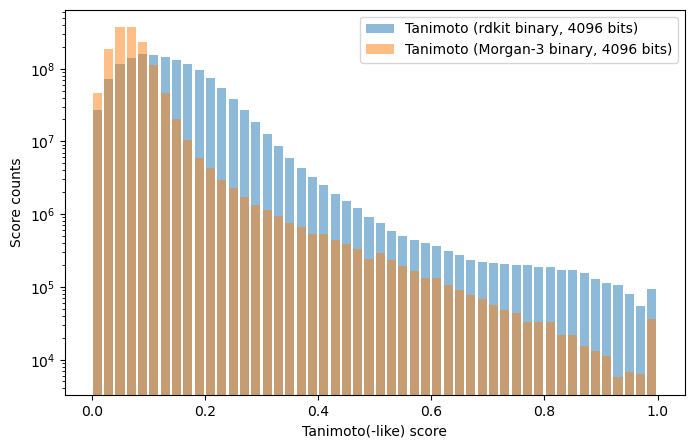

In [13]:
NBITS = 4096

compare_distributions(
    similarities_classic,
    similarities_morgan3,
    f"Tanimoto (rdkit binary, {NBITS} bits)",
    f"Tanimoto (Morgan-3 binary, {NBITS} bits)",
    ignore_diagonal=True,
)

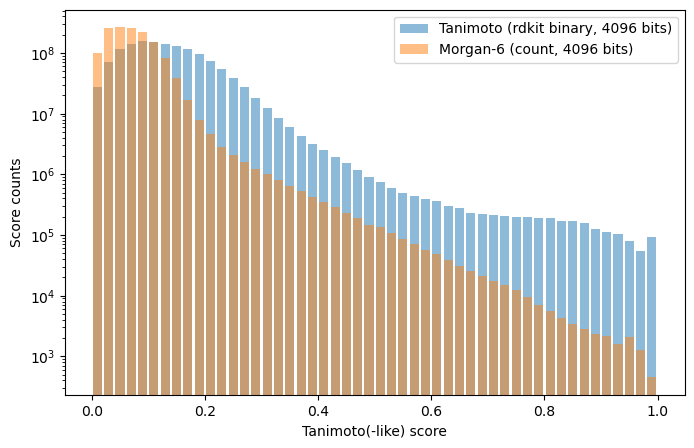

In [29]:
NBITS = 4096

compare_distributions(similarities_rdkit,
                      similarities_count_morgan6,
                      f"Tanimoto (rdkit binary, {NBITS} bits)",
                      f"Morgan-6 (count, {NBITS} bits)",
)

## Adjust different score scales!

The two distributions above show that there is a huge discrepancy in how the scores are distributet. That also means: in how likely it is for a molecular pair to obtain a certain score!

**AIM**: bring all scores to the same overall distribution!?

### Adjust all to the same distribution --> use percentiles!

In [5]:
from utils import percentile_scores

In [6]:
%%time

scaled_similarities_rdkit = percentile_scores(similarities_rdkit)

CPU times: user 1min 27s, sys: 6.34 s, total: 1min 33s
Wall time: 1min 33s


## Scale other scores

In [8]:
%%time

scaled_similarities_rdkit_count = percentile_scores(similarities_rdkit_count)

CPU times: user 1min 36s, sys: 6.91 s, total: 1min 43s
Wall time: 1min 43s


In [18]:
%%time

scaled_similarities_morgan3 = percentile_scores(similarities_morgan3)

CPU times: user 3min 36s, sys: 7.68 s, total: 3min 44s
Wall time: 3min 44s


In [19]:
%%time

scaled_similarities_morgan3_count = percentile_scores(similarities_morgan3_count)

CPU times: user 2min 20s, sys: 7.6 s, total: 2min 27s
Wall time: 2min 27s


In [18]:
%%time

scaled_similarities_morgan9_count = percentile_scores(similarities_morgan9_count)

CPU times: user 2min 9s, sys: 16.5 s, total: 2min 26s
Wall time: 2min 26s


In [21]:
%%time

scaled_similarities_map4 = percentile_scores(similarities_map4)

CPU times: user 1min 32s, sys: 12.2 s, total: 1min 44s
Wall time: 1min 44s


In [9]:
#np.save("scaled_similarities_rdkit_binary_4096bits.npy", scaled_similarities_rdkit.astype(np.float32))
#np.save("scaled_similarities_rdkit_count_4096bits.npy", scaled_similarities_rdkit_count.astype(np.float32))
#np.save("scaled_similarities_morgan3_binary_4096bits.npy", scaled_similarities_morgan3.astype(np.float32))
#np.save("scaled_similarities_morgan3_count_4096bits.npy", scaled_similarities_morgan3_count.astype(np.float32))
#np.save("scaled_similarities_morgan9_count_4096bits.npy", scaled_similarities_morgan9_count.astype(np.float32))
#np.save("scaled_similarities_map4_4096bits.npy", scaled_similarities_map4.astype(np.float32))

In [5]:
scaled_similarities_rdkit = np.load("scaled_similarities_rdkit_binary_4096bits.npy")
scaled_similarities_morgan3 = np.load("scaled_similarities_morgan3_binary_4096bits.npy")
scaled_similarities_morgan3_count = np.load("scaled_similarities_morgan3_count_4096bits.npy")
#scaled_similarities_morgan9_count = np.load("scaled_similarities_morgan9_count_4096bits.npy")
scaled_similarities_map4 = np.load("scaled_similarities_map4_4096bits.npy")

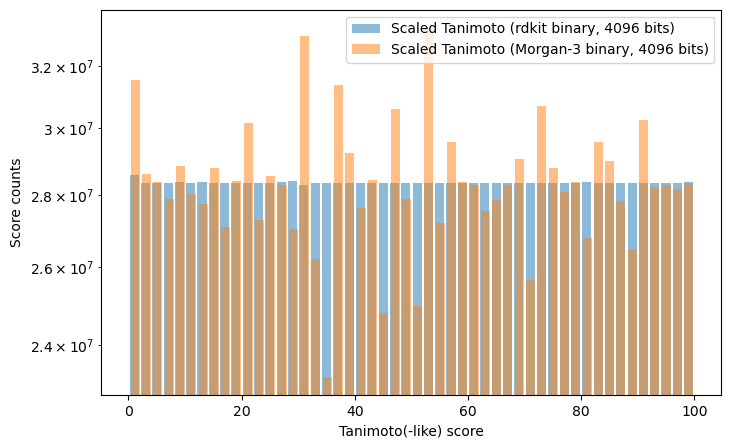

In [15]:
NBITS = 4096

compare_distributions(
    scaled_similarities_rdkit,
    scaled_similarities_morgan3,
    f"Scaled Tanimoto (rdkit binary, {NBITS} bits)",
    f"Scaled Tanimoto (Morgan-3 binary, {NBITS} bits)",
    ignore_diagonal=True,
)

## Compute and scale similarity scores of sparse variants

In [ ]:
from fingerprint_computation import compute_fingerprints_from_smiles
from metrics import generalized_tanimoto_similarity_matrix_sparse, jaccard_similarity_matrix_sparse
from metrics import jaccard_similarity_matrix

from typing import List
from rdkit.Chem import Mol, MolFromSmiles
from map4 import MAP4


def compute_map_fingerprints_from_smiles(smiles, map_generator):
    
    molecules: List[Mol] = [MolFromSmiles(s) for s in smiles]
    fingerprints_map: np.ndarray = map_generator.calculate_many(
        molecules,
        number_of_threads=32,
        verbose=True,
    )
    return list(fingerprints_map)


def compute_sparse_map_fingerprints_from_smiles(
    smiles,
    map_generator,
    count=False,
    ):
    molecules: List[Mol] = [MolFromSmiles(s) for s in smiles]
    fingerprints_map: np.ndarray = map_generator.calculate_many_sparse(
        molecules,
        number_of_threads=32,
        verbose=True,
        count=count,
    )
    return list(fingerprints_map)


def compute_sparse_map_fingerprints_from_smiles_serial(
        smiles,
        map_generator
        ):

    molecules: List[Mol] = [MolFromSmiles(s) for s in smiles]
    fingerprints = []
    for mol in tqdm(molecules):
        fp_bits = map_generator._calculate(mol)
        fingerprints.append(np.sort(map_generator.encoder.hash(fp_bits)))
    return fingerprints

## Morgen3 count, sparse

In [8]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=True,
    sparse=True,
    progress_bar=True
)

100%|███████████████████████████████████| 37811/37811 [00:05<00:00, 6490.86it/s]


In [13]:
similarities = generalized_tanimoto_similarity_matrix_sparse(
    fingerprints_morgan3_sparse, fingerprints_morgan3_sparse)

scaled_similarities_morgan3_count_sparse = percentile_scores(similarities)

## Morgan3 binary, sparse

In [14]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3 = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=False,
    sparse=True,
    progress_bar=True
)

100%|███████████████████████████████████| 37811/37811 [00:05<00:00, 7096.65it/s]


In [15]:
%%time

similarities = jaccard_similarity_matrix_sparse(
    fingerprints_morgan3, fingerprints_morgan3)

scaled_similarities_morgan3_sparse = percentile_scores(similarities)

CPU times: user 16min 28s, sys: 14.5 s, total: 16min 42s
Wall time: 4min 27s


## Morgan9 count, sparse

In [13]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=9, fpSize=4096)

fingerprints_morgan9_count = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=True,
    sparse=True,
    progress_bar=True
)

100%|███████████████████████████████████| 37811/37811 [00:09<00:00, 4144.93it/s]


In [14]:
%%time

similarities = generalized_tanimoto_similarity_matrix_sparse(
    fingerprints_morgan9_count, fingerprints_morgan9_count)

scaled_similarities_morgan9_count_sparse = percentile_scores(similarities)

CPU times: user 19min 56s, sys: 11.8 s, total: 20min 8s
Wall time: 3min 10s


In [15]:
np.save(
    "scaled_similarities_morgan9_count_sparse.npy",
    scaled_similarities_morgan9_count_sparse.astype(np.float32)
)

In [16]:
#np.save("scaled_similarities_rdkit_binary_4096bits.npy", scaled_similarities_rdkit.astype(np.float32))
#np.save("scaled_similarities_morgan3_binary_sparse.npy", scaled_similarities_morgan3_sparse.astype(np.float32))
#np.save("scaled_similarities_morgan3_count_sparse.npy", scaled_similarities_morgan3_count_sparse.astype(np.float32))
#np.save("scaled_similarities_morgan9_count_4096bits.npy", scaled_similarities_morgan9_count.astype(np.float32))
#np.save("scaled_similarities_map4_4096bits.npy", scaled_similarities_map4.astype(np.float32))

## RDKit binary, sparse

In [7]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=False,
    sparse=True,
    progress_bar=True
)

100%|████████████████████████████████████| 37811/37811 [00:40<00:00, 940.65it/s]


In [8]:
%%time

similarities = jaccard_similarity_matrix_sparse(
    fingerprints_rdkit_sparse, fingerprints_rdkit_sparse
)

scaled_similarities_rdkit_sparse = percentile_scores(similarities)

CPU times: user 2h 59min, sys: 17.4 s, total: 2h 59min 17s
Wall time: 7min 59s


In [9]:
np.save(
    "scaled_similarities_rdkit_binary_sparse.npy",
    scaled_similarities_rdkit_sparse.astype(np.float32)
)

## RDKit count, sparse

In [7]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_count_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=True,
    sparse=True,
    progress_bar=True
)

100%|████████████████████████████████████| 37811/37811 [00:47<00:00, 802.93it/s]


In [8]:
%%time

similarities = generalized_tanimoto_similarity_matrix_sparse(
    fingerprints_rdkit_count_sparse, fingerprints_rdkit_count_sparse)

scaled_similarities_rdkit_count_sparse = percentile_scores(similarities)

CPU times: user 2h 41min 53s, sys: 17.5 s, total: 2h 42min 11s
Wall time: 9min 33s


In [9]:
np.save(
    "scaled_similarities_rdkit_count_sparse.npy",
    scaled_similarities_rdkit_count_sparse.astype(np.float32)
)

## MAP4

In [10]:
from map4 import MAP4

map4gen = MAP4(
    dimensions=4096,
    radius=2,
    include_duplicated_shingles=False,
)

fingerprints_map4_sparse = compute_sparse_map_fingerprints_from_smiles_serial(compounds.smiles, map4gen)

  0%|          | 0/37811 [00:00<?, ?it/s]

In [11]:
%%time

similarities= jaccard_similarity_matrix_sparse(
    fingerprints_map4_sparse, fingerprints_map4_sparse
)

scaled_similarities_map4_sparse = percentile_scores(similarities)

CPU times: user 1h 59min 5s, sys: 15.9 s, total: 1h 59min 21s
Wall time: 5min 57s


In [12]:
np.save(
    "scaled_similarities_tanimoto_map4_sparse.npy",
    scaled_similarities_map4_sparse.astype(np.float32)
)

## Compare score vs. score using heatmap

In [7]:
from visualizations import heatmap_comparison_scaled_bins

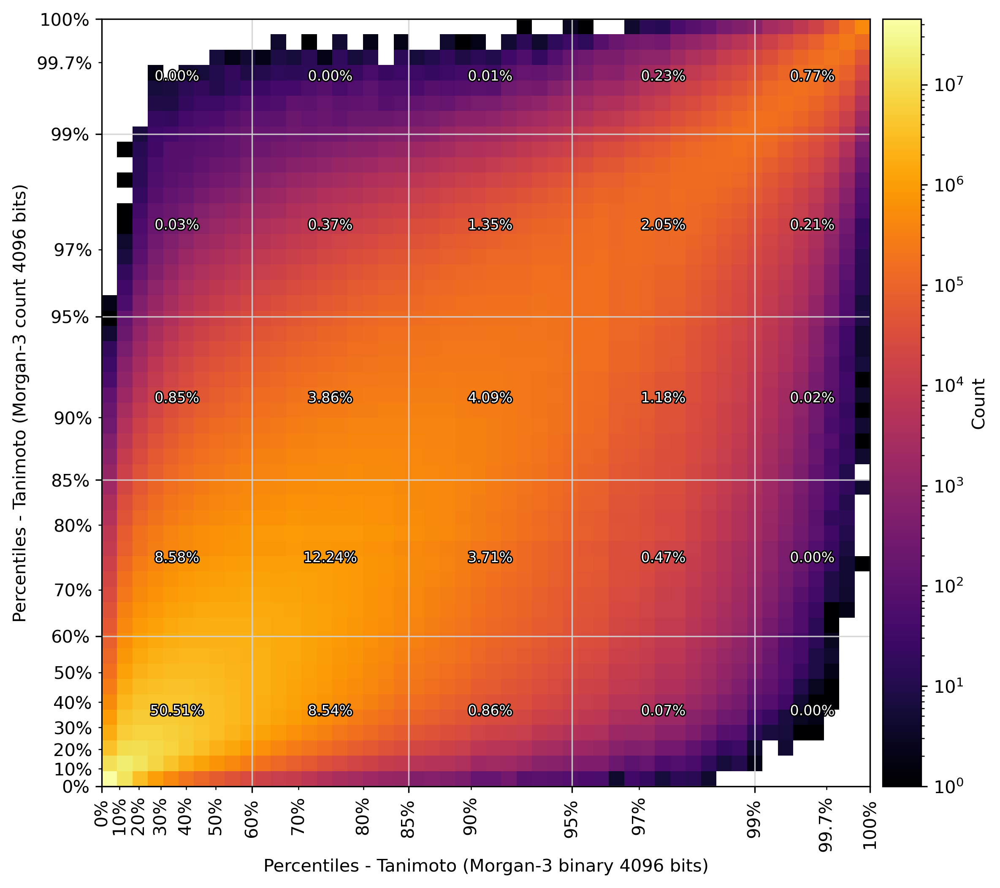

In [12]:
NBITS = 4096

heatmap_comparison_scaled_bins(
    scaled_similarities_morgan3,
    scaled_similarities_morgan3_count,
    f"Percentiles - Tanimoto (Morgan-3 binary {NBITS} bits)",
    f"Percentiles - Tanimoto (Morgan-3 count {NBITS} bits)",
    bins=50,
    colormap="inferno",
    filename="heatmap_neg_log_morgan3_binary_vs_morgan3_count.png"
)

In [18]:
from rdkit import Chem
from rdkit.Chem import Draw


def select_pairs_from_ids(idx, n_pairs=10):
    pairs = list(zip(idx[0], idx[1]))
    
    # Step 1: Sort each pair so that (smaller, larger)
    sorted_pairs = {(min(a, b), max(a, b)) for a, b in pairs}
    
    # Step 2: Convert to a sorted list of unique pairs
    unique_pairs = list(sorted_pairs)
    
    # Step 3: Select only one per first ID
    selected_pairs = {}
    for a, b in unique_pairs:
        if a not in selected_pairs:
            selected_pairs[a] = (a, b)
        else:
            # Randomly decide whether to replace existing pair
            if random.random() > 0.5:
                selected_pairs[a] = (a, b)
    
    # Convert dictionary values back to a list
    final_pairs = list(selected_pairs.values())
    if len(final_pairs) < n_pairs:
        n_pairs = len(final_pairs)
    select_ids = np.random.choice(np.arange(len(final_pairs)), n_pairs, replace=False)
    return [final_pairs[i] for i in select_ids]


def show_pairs_in_grid(unique_pairs, ncols=2, figsize=(30, 18), dpi=300, filename=None):
    nrows = -(-len(unique_pairs) // ncols)  # Ceiling division to get number of rows
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, dpi=dpi)
    axes = axes.flatten()  # Flatten to iterate easily

    for i, pair in enumerate(unique_pairs):
        id1, id2 = pair
        ax = axes[i]
        
        # Get SMILES and render molecules
        smiles1 = compounds.smiles[id1]
        smiles2 = compounds.smiles[id2]
        mol1 = Chem.MolFromSmiles(smiles1)
        mol2 = Chem.MolFromSmiles(smiles2)
        img = Draw.MolsToGridImage([mol1, mol2], molsPerRow=2, subImgSize=(800, 800), returnPNG=False)
        
        ax.imshow(img)
        ax.axis('off')
        
        # Get and display score summary below the molecules
        scores = get_score_summary(id1, id2)
        ax.set_title(f"Pair {i + 1}")
        ax.text(0.5, 0, scores, #.to_string(header=False), 
                transform=ax.transAxes, ha='center', fontsize=10, family='monospace')
    
    # Hide any unused subplots if number of pairs is less than grid size
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    if filename is not None:
        plt.savefig(filename)
    plt.show()


In [49]:
def get_score_summary(id1, id2):
    output = f"Scaled Tanimoto (Morgan-3 binary): {scaled_similarities_morgan3[id1, id2]:.4f}" \
    + f"(actual score: {similarities_morgan3[id1, id2]:.4f})\n"\
    + f"Scaled Ruzicka (Morgan-3 count fp): {scaled_similarities_morgan3_count[id1, id2]:.4f}"\
    + f"(actual score: {similarities_morgan3_count[id1, id2]:.4f})\n"
    return output

In [59]:
idx = np.where((scaled_similarities_morgan3_count > 99.7) \
               & (scaled_similarities_morgan3 < 90) \
              )
idx[0].shape

(232,)

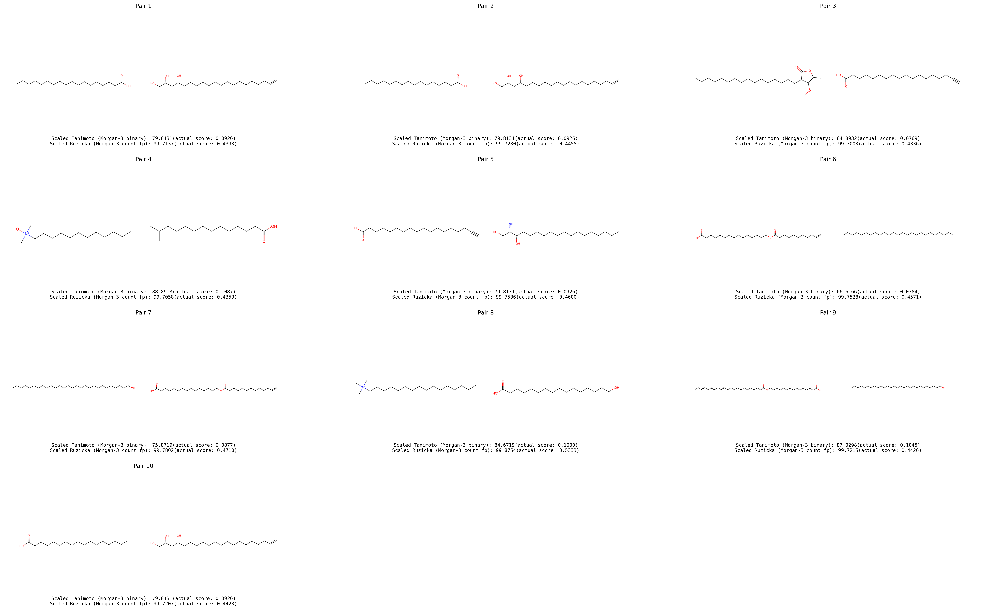

In [61]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_morgan3_count_vs_binary_01.pdf"
                  )

In [62]:
idx = np.where((scaled_similarities_morgan3_count > 99.8) \
               & (scaled_similarities_morgan3 < 95) \
              )
idx[0].shape

(136,)

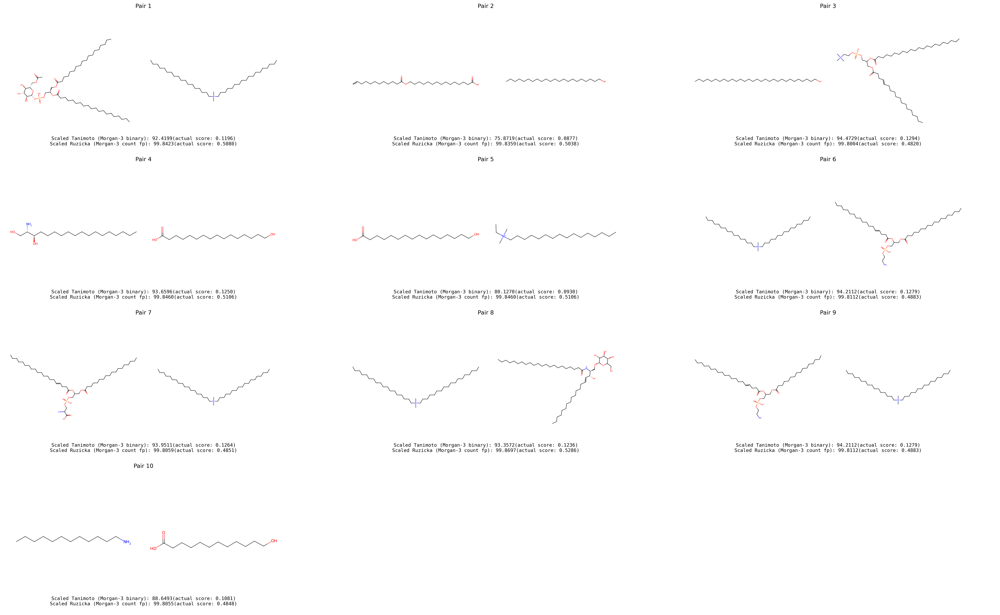

In [64]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_morgan3_count_vs_binary_03.pdf"
                  )

In [65]:
idx = np.where((scaled_similarities_morgan3_count < 90) \
               & (scaled_similarities_morgan3 > 99.9) \
              )
idx[0].shape

(30,)

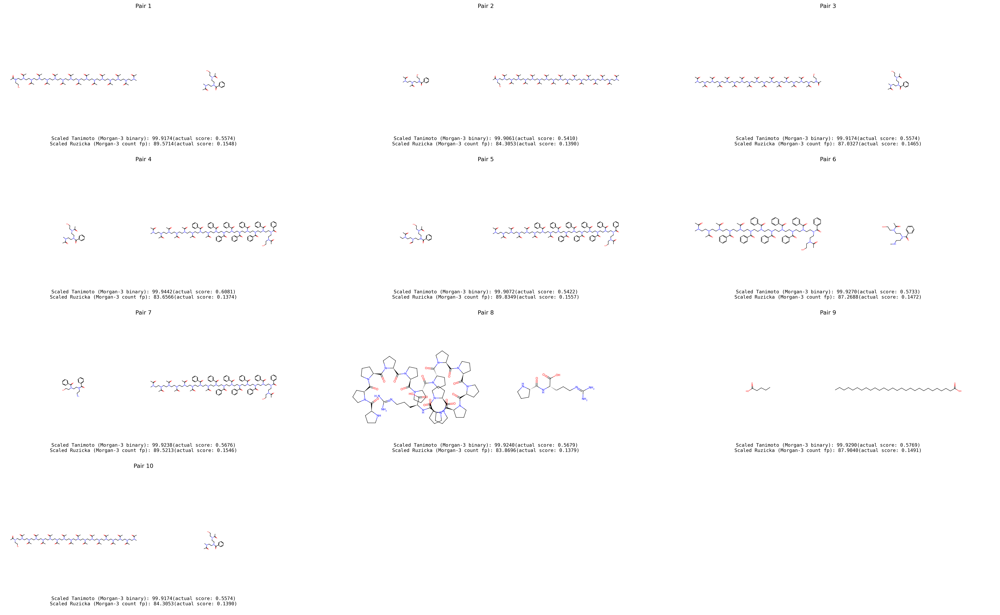

In [66]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_morgan3_count_vs_binary_02.pdf"
                  )

# rdkit (binary) vs Morgan3 (binary)

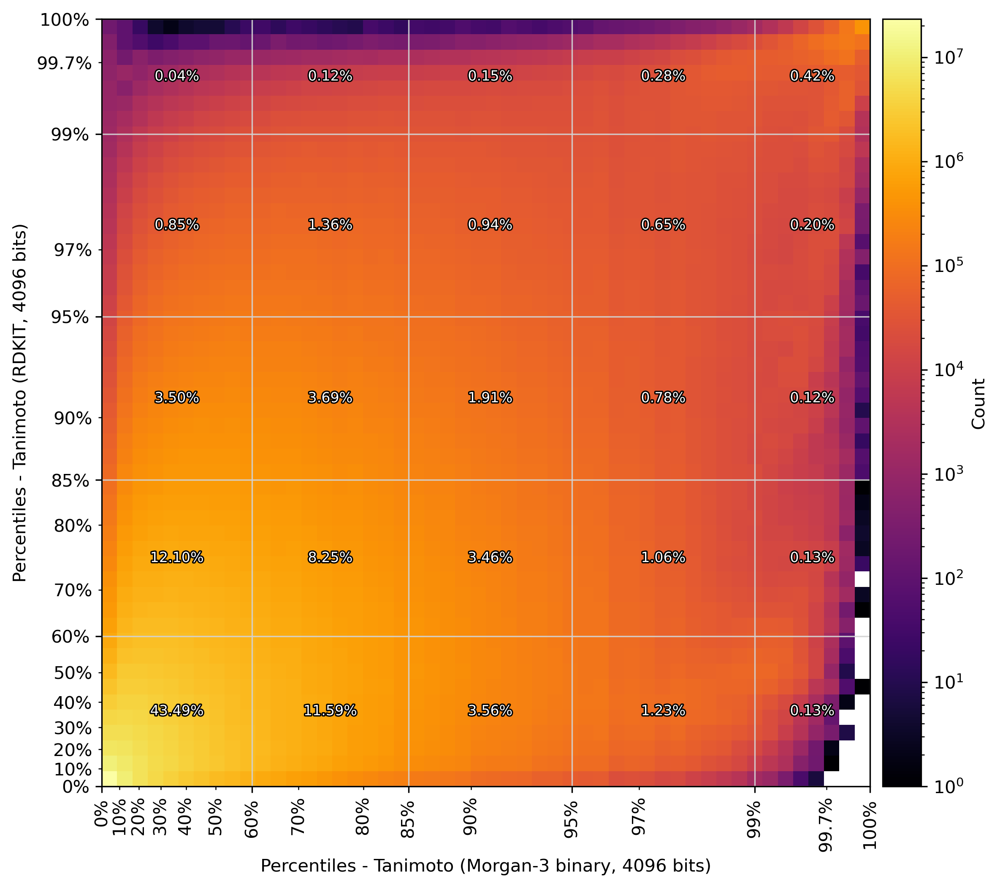

In [33]:
NBITS = 4096

heatmap_comparison_scaled_bins(
    scaled_similarities_morgan3,
    scaled_similarities_rdkit,
    f"Percentiles - Tanimoto (Morgan-3 binary, {NBITS} bits)",
    f"Percentiles - Tanimoto (RDKIT, {NBITS} bits)",
    bins=50,
    colormap="inferno",
    filename="heatmap_neg_log_morgan3_binary_vs_rdkit_binary.png"
)

In [36]:
0.04/100*(37811*(37811-1)/2)

285926.782

In [37]:
0.13/100*(37811*(37811-1)/2)

929262.0414999999

In [67]:
def get_score_summary(id1, id2):
    output = f"Scaled Tanimoto (Morgan-3 binary): {scaled_similarities_morgan3[id1, id2]:.4f}" \
    + f"(actual score: {similarities_morgan3[id1, id2]:.4f})\n"\
    + f"Scaled Tanimoto (rdkit): {scaled_similarities_rdkit[id1, id2]:.4f}"\
    + f"(actual score: {similarities_rdkit[id1, id2]:.4f})\n"
    return output

In [68]:
idx = np.where((scaled_similarities_rdkit < 80) \
               & (scaled_similarities_morgan3 > 99.9) \
              )
idx[0].shape

(72,)

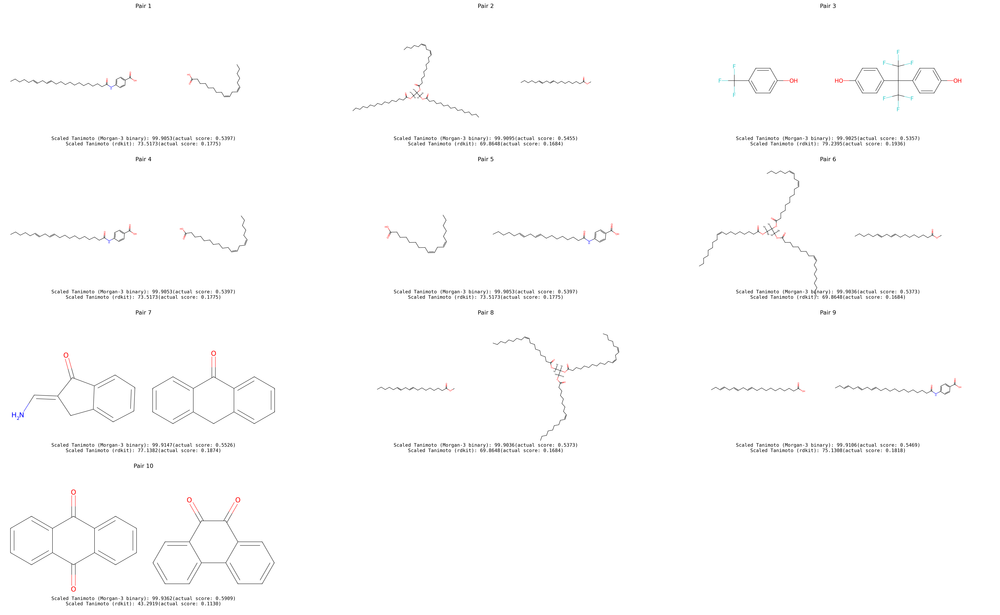

In [69]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_tanimoto_morgan3_vs_rdkit_01.pdf"
                  )

In [70]:
idx = np.where((scaled_similarities_rdkit > 99.9) \
               & (scaled_similarities_morgan3 < 60) \
              )
idx[0].shape

(768,)

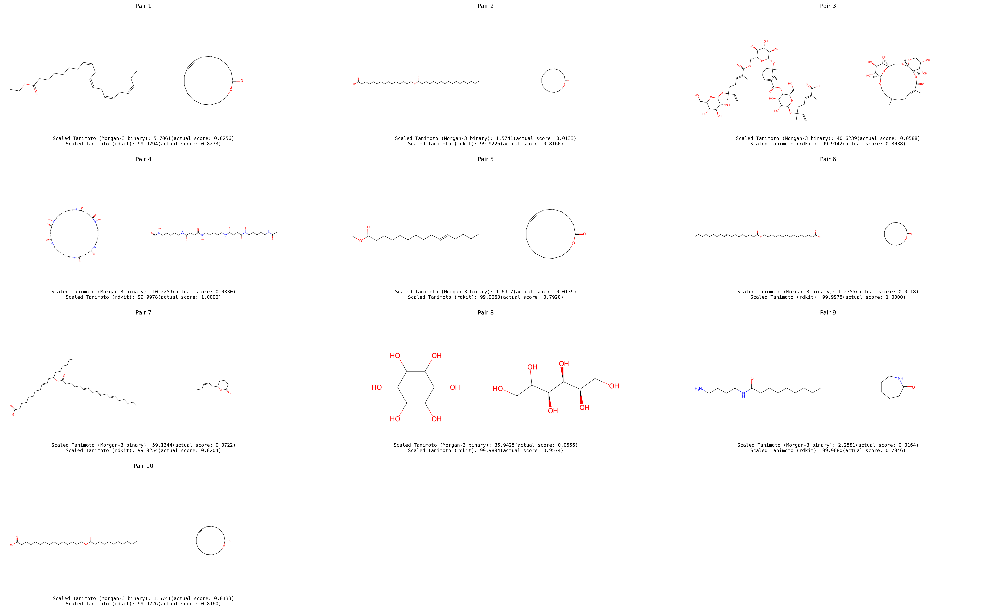

In [71]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_tanimoto_morgan3_vs_rdkit_02.pdf"
                  )

# rdkit (count) vs Morgan3 (count)

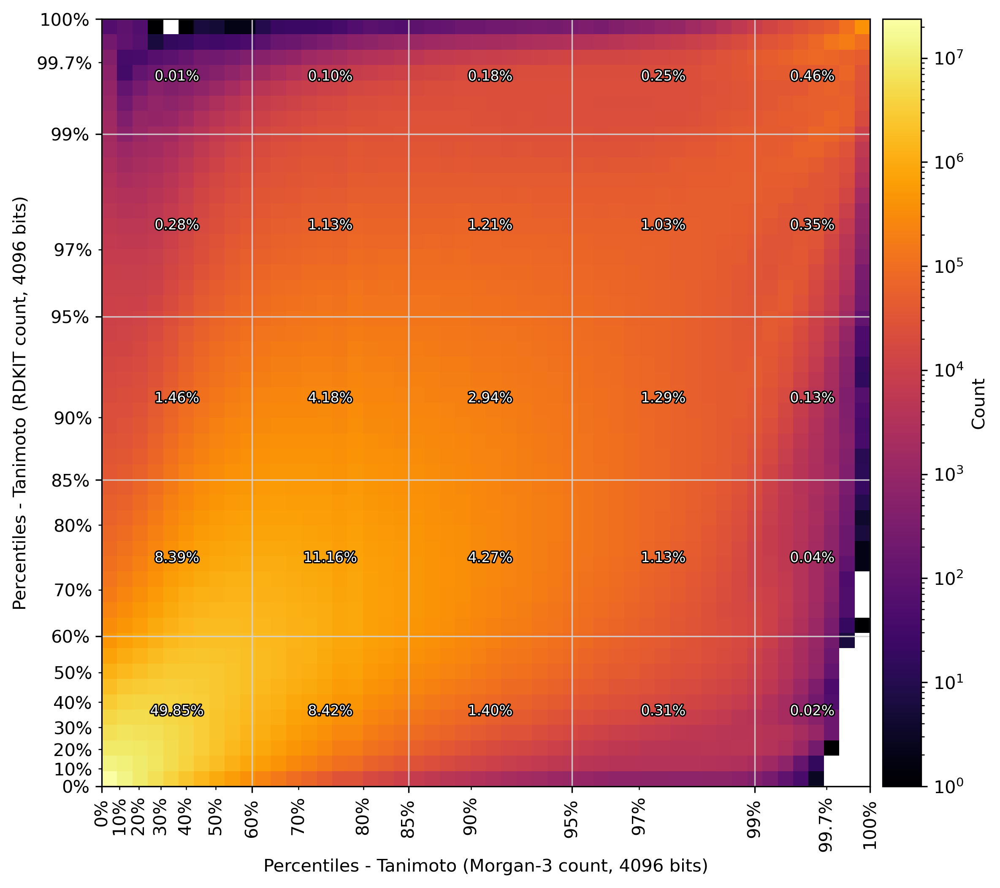

In [13]:
NBITS = 4096

heatmap_comparison_scaled_bins(
    scaled_similarities_morgan3_count,
    scaled_similarities_rdkit_count,
    f"Percentiles - Tanimoto (Morgan-3 count, {NBITS} bits)",
    f"Percentiles - Tanimoto (RDKIT count, {NBITS} bits)",
    bins=50,
    colormap="inferno",
    filename="heatmap_neg_log_morgan3_count_vs_rdkit_count.png"
)

In [15]:
def get_score_summary(id1, id2):
    output = f"Scaled Tanimoto (Morgan-3 count): {scaled_similarities_morgan3_count[id1, id2]:.4f}" \
    + f"(actual score: {similarities_morgan3_count[id1, id2]:.4f})\n"\
    + f"Scaled Tanimoto (rdkit): {scaled_similarities_rdkit_count[id1, id2]:.4f}"\
    + f"(actual score: {similarities_rdkit_count[id1, id2]:.4f})\n"
    return output

In [16]:
idx = np.where((scaled_similarities_rdkit_count < 80) \
               & (scaled_similarities_morgan3_count > 99.9) \
              )
idx[0].shape

(28,)

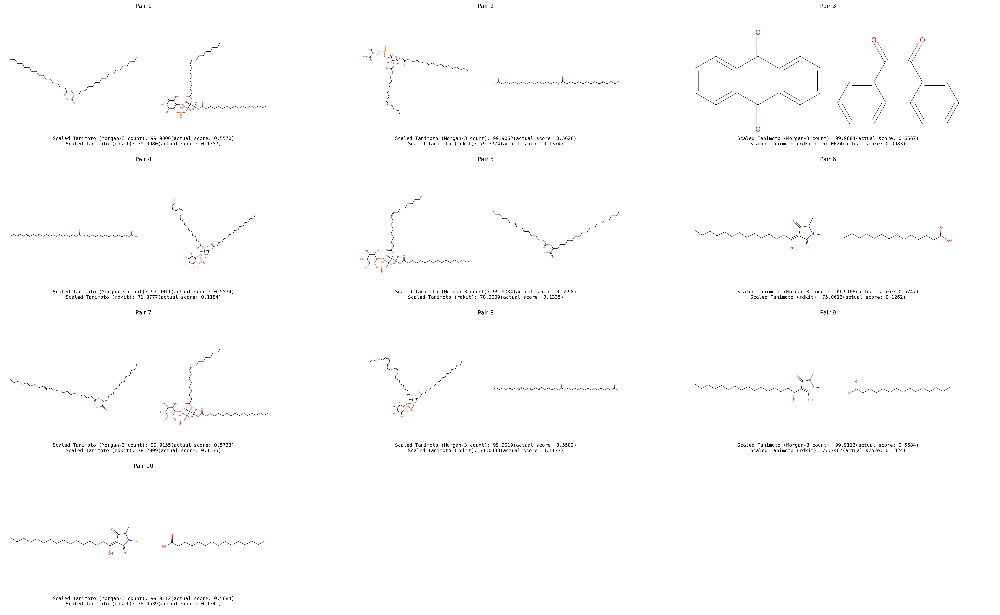

In [21]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_morgan3_count_vs_rdkit_count_01.pdf"
                  )

In [24]:
idx = np.where((scaled_similarities_rdkit_count > 99.9) \
               & (scaled_similarities_morgan3_count < 40) \
              )
idx[0].shape

(464,)

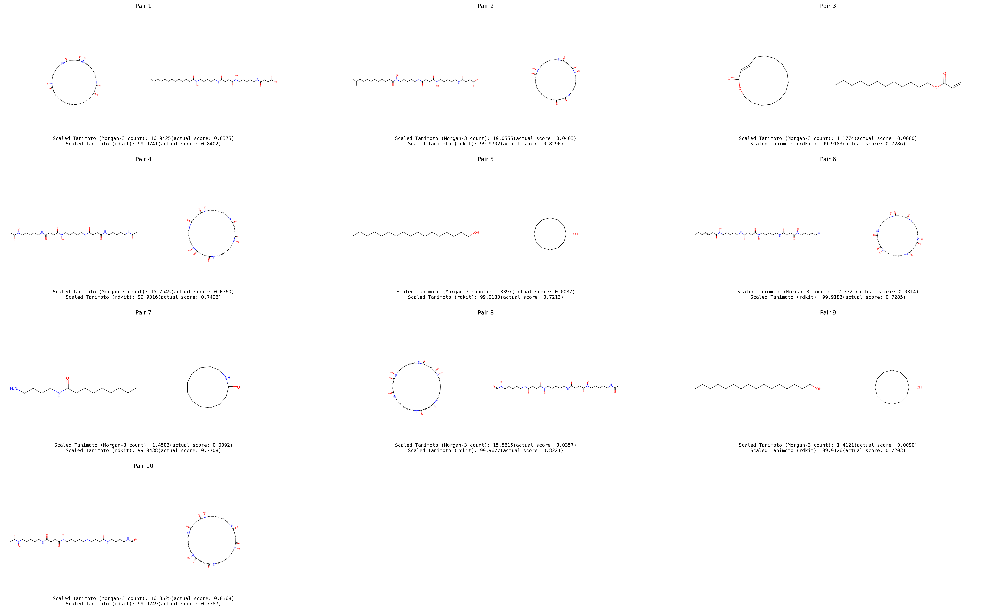

In [25]:
show_pairs_in_grid(
    select_pairs_from_ids(idx, 10), 3,
    filename="examples_morgan3_count_vs_rdkit_count_02.pdf"
)

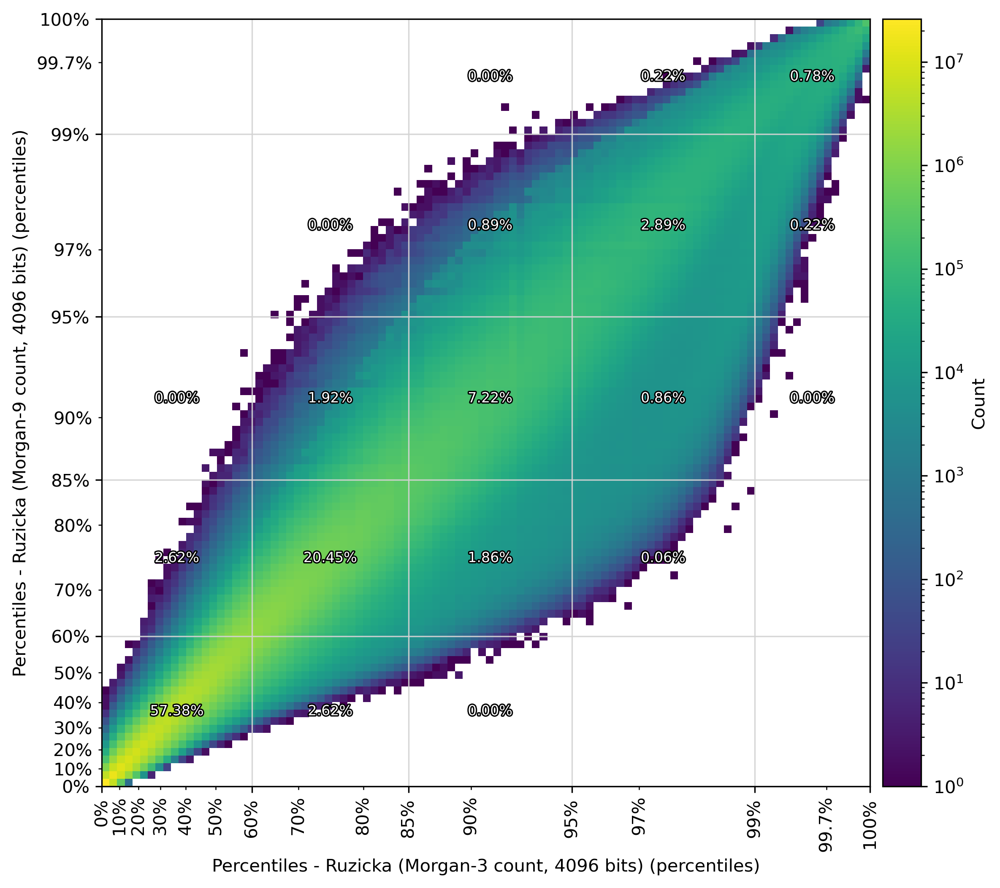

In [33]:
NBITS = 4096

heatmap_comparison_scaled_bins(
    scaled_similarities_morgan3_count,
    scaled_similarities_morgan9_count,
    f"Percentiles - Tanimoto (Morgan-3 count, {NBITS} bits)",
    f"Percentiles - Tanimoto (Morgan-9 count, {NBITS} bits)",
    bins=50,
    colormap="inferno",
    filename="heatmap_neg_log_morgan9_count_vs_morgan3_count.png"
)

# MAP4 vs morgan count

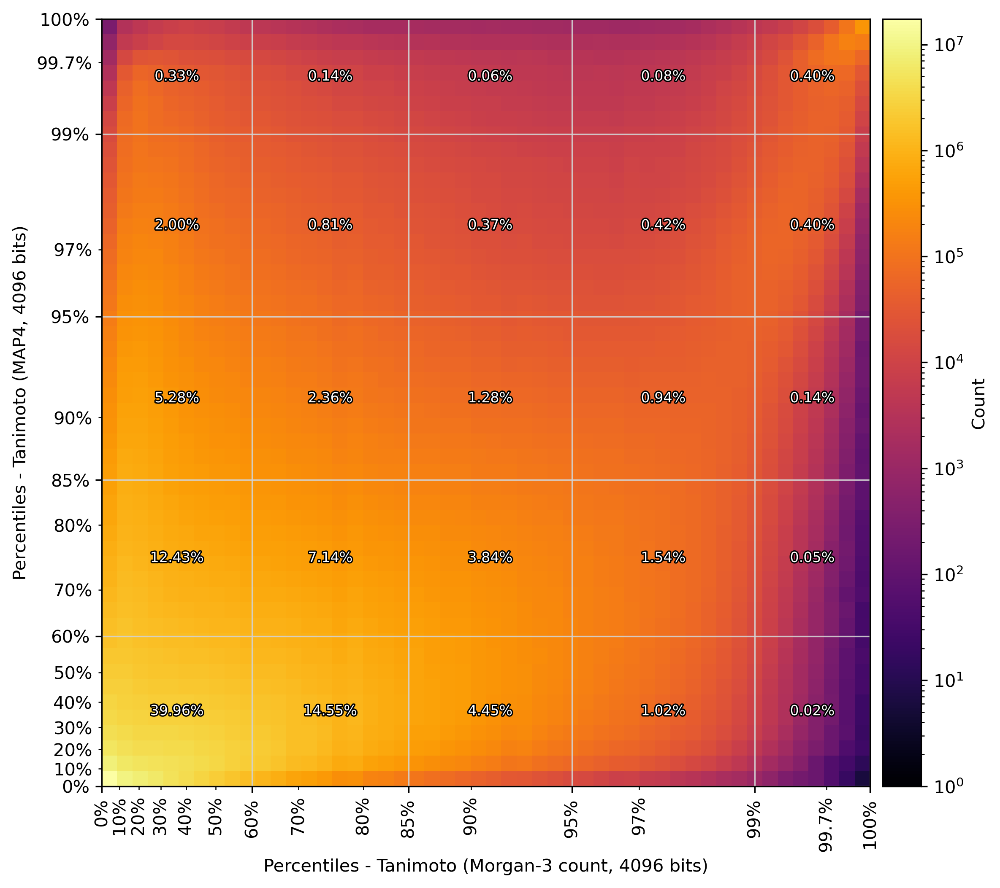

In [8]:
NBITS = 4096

heatmap_comparison_scaled_bins(
    scaled_similarities_morgan3_count,
    scaled_similarities_map4,
    f"Percentiles - Tanimoto (Morgan-3 count, {NBITS} bits)",
    f"Percentiles - Tanimoto (MAP4, {NBITS} bits)",
    bins=50,
    colormap="inferno",
    filename="heatmap_neg_log_morgan3_count_vs_map4.png"
)

In [11]:
def get_score_summary(id1, id2):
    output = f"Scaled Tanimoto (MAP4): {scaled_similarities_map4[id1, id2]:.4f}" \
    + f" (actual score: {similarities_map4[id1, id2]:.4f})\n"\
    + f"Scaled Ruzicka (Morgan-3 count fp): {scaled_similarities_morgan3_count[id1, id2]:.4f}"\
    + f" (actual score: {similarities_morgan3_count[id1, id2]:.4f})\n"
    return output

In [13]:
idx = np.where((scaled_similarities_map4 > 99.999) \
               & (scaled_similarities_morgan3_count < 50) \
              )
idx[0].shape

(236,)

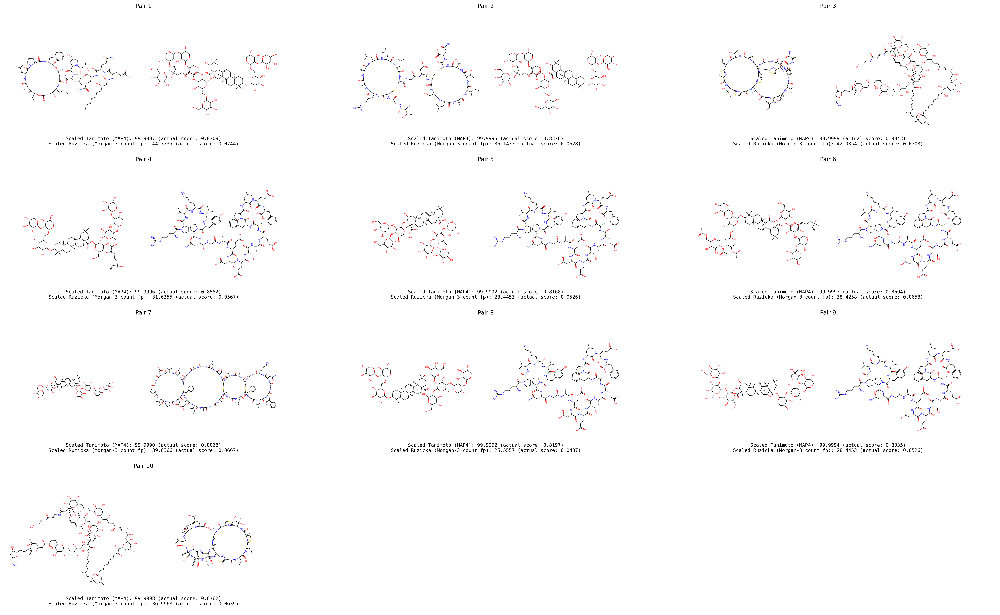

In [20]:
show_pairs_in_grid(
    select_pairs_from_ids(idx, 10), 3,
    filename="examples_tmap4_vs_morgan3_count_01.pdf"
)

In [21]:
idx = np.where((scaled_similarities_map4 > 99.995) \
               & (scaled_similarities_morgan3_count < 30) \
              )
idx[0].shape

(784,)

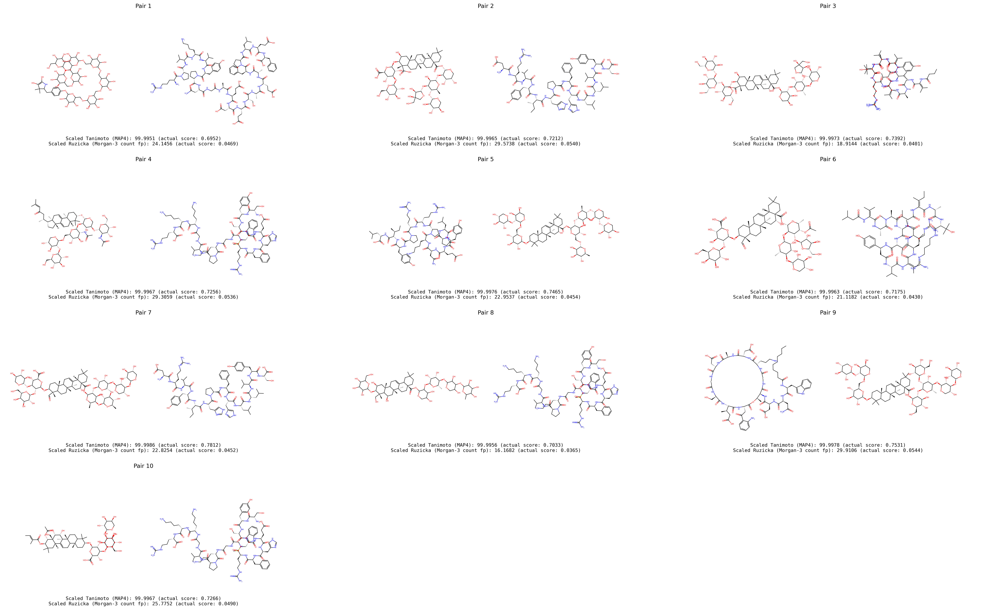

In [22]:
show_pairs_in_grid(
    select_pairs_from_ids(idx, 10), 3,
    filename="examples_tmap4_vs_morgan3_count_01b.pdf"
)

In [79]:
idx = np.where((scaled_similarities_map4 < 50) \
               & (scaled_similarities_morgan3_count > 99.9) \
              )
idx[0].shape

(332,)

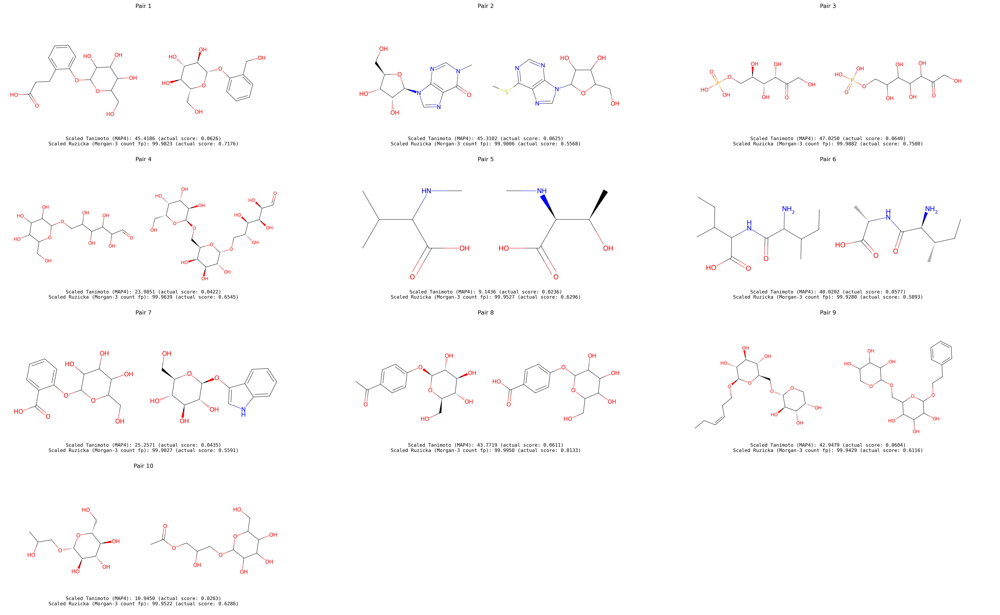

In [80]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_tmap4_vs_morgan3_count_02.pdf"
                  )

In [81]:
for pair in select_pairs_from_ids(idx, 3):
    print(f"{compounds.smiles[pair[0]]} --- vs --- {compounds.smiles[pair[1]]}")

C([C@@H]1[C@H]([C@@H]([C@H](C(O1)O)O)O)O)OP(=O)(O)O --- vs --- C(C1C(C(C(C(O1)OP(=O)(O)O)O)O)O)OP(=O)(O)O
OCC(O)[C@@H](O)[C@H](O)[C@H](O)CO[C@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O --- vs --- C(C1C(C(C(C(O1)OC(C(CO)O)C(C(CO)O)O)O)O)O)O
O=c1ncccn1[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O --- vs --- C1=CN(C(=O)N=C1N)C2C(C(C(O2)CO)O)O


In [82]:
idx = np.where((scaled_similarities_map4 < 80) \
               & (scaled_similarities_morgan3_count > 99.99) \
              )
idx[0].shape

(38,)

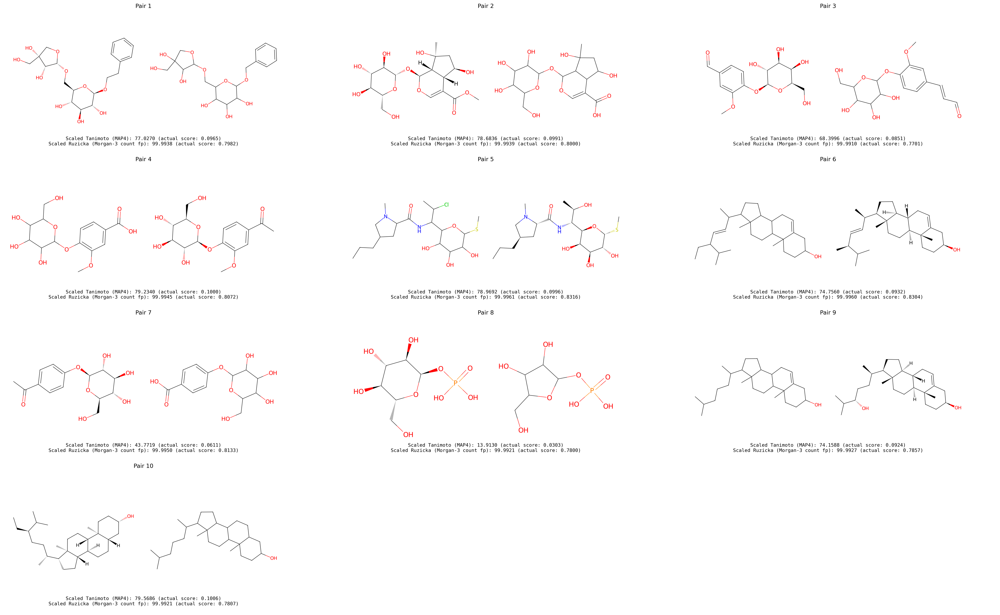

In [83]:
show_pairs_in_grid(select_pairs_from_ids(idx, 10), 3,
                   filename="examples_tmap4_vs_morgan3_count_03.pdf"
                  )

8601 8570


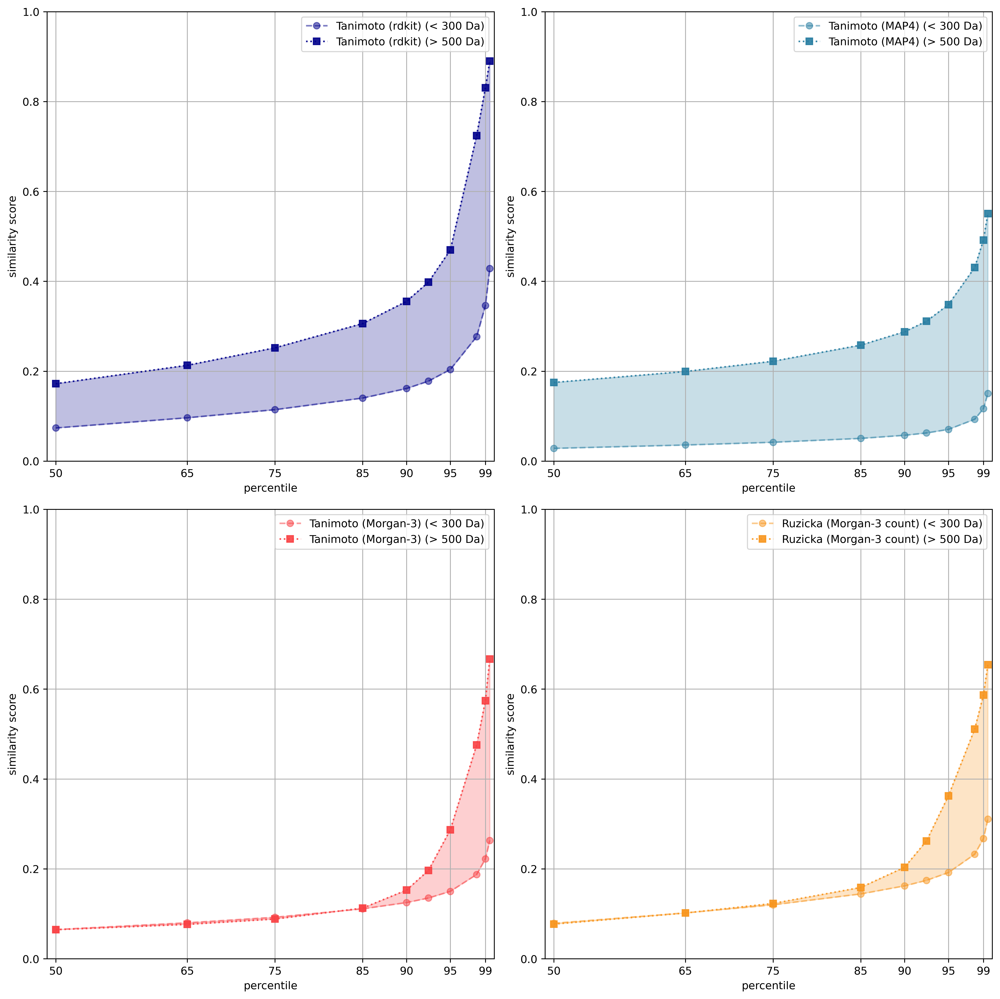

In [28]:
#percentiles = np.arange(0, 101)
percentiles = [50, 65, 75, 85, 90, 92.5, 95, 98, 99, 99.5] #, 99.9]
percentiles_ticks = [50, 65, 75, 85, 90, 95, 99]

mass_low = 300
mass_high = 500

idx1 = np.where(compounds.mass > mass_high)[0]
idx0 = np.where(compounds.mass < mass_low)[0]
print(idx0.shape[0], idx1.shape[0])

similarities_dict = {
    "Tanimoto (rdkit)": similarities_rdkit,
    "Tanimoto (MAP4)": similarities_map4,
    "Tanimoto (Morgan-3)": similarities_morgan3,
    #"Ruzicka (Morgan-2 count, 4096 bits)": similarities_morgan2_count,
    "Ruzicka (Morgan-3 count)": similarities_morgan3_count,
    #"Ruzicka (Morgan-6 count)": similarities_morgan6_count,
    #"Ruzicka (Morgan-9 count)": similarities_morgan9_count,
}

# Compare selected percentiles
fig, axes = plt.subplots(2, 2, figsize=(13, 13), dpi=450)


#colors = ["darkblue", "dodgerblue", "teal", "darkred", "crimson", "orange"]
colors = ["darkblue", "#277DA1", #"#4D908E",
          "#F94144", "#F8961E", "#F9C74F"]

curves =  {key: {} for key, _ in similarities_dict.items()}

coords = [(0, 0), (0, 1), #(0, 2),
          (1, 0), (1, 1), #(1, 2)
         ]

for i, (key, similarities) in enumerate(similarities_dict.items()):
    percentile_scores = np.percentile(similarities[np.ix_(idx0, idx0)].reshape(-1), percentiles)
    curves[key][mass_low] = percentile_scores
    axes[coords[i]].plot(percentiles, percentile_scores, ".--", markersize=12, label=key+f" (< {mass_low} Da)", color=colors[i], alpha=0.5)

    percentile_scores = np.percentile(similarities[np.ix_(idx1, idx1)].reshape(-1), percentiles)
    curves[key][mass_high] = percentile_scores
    axes[coords[i]].plot(percentiles, percentile_scores, "s:", markersize=6, label=key+f" (> {mass_high} Da)", color=colors[i],  alpha=0.9)

for i, (key, similarities) in enumerate(similarities_dict.items()):
    axes[coords[i]].fill_between(percentiles, curves[key][mass_low], curves[key][mass_high], color=colors[i], alpha=0.25)

    axes[coords[i]].set_xticks(percentiles_ticks, [str(x) for x in percentiles_ticks])
    axes[coords[i]].grid(True)
    axes[coords[i]].set_xlabel("percentile")
    axes[coords[i]].set_ylabel("similarity score")
    axes[coords[i]].set_ylim(0, 1)
    axes[coords[i]].set_xlim(49, 100)
    axes[coords[i]].legend()

plt.tight_layout()
plt.savefig("fig_low_high_mass_score_percentiles.pdf")
plt.savefig("fig_low_high_mass_score_percentiles.png", dpi=400)
plt.show()

# Score vs Score comparisons

In [13]:
from visualizations import heatmap_comparison

## Tanimoto (rdkit) vs Tanimoto (Morgan-3)

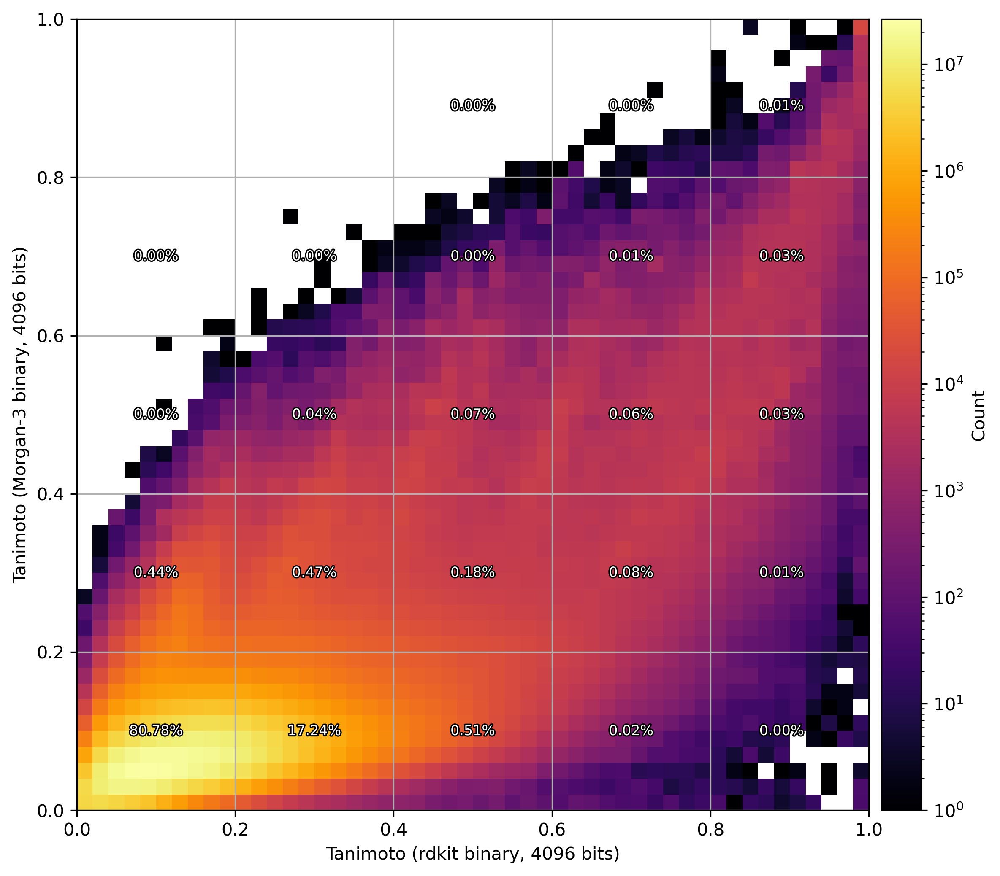

In [88]:
heatmap_comparison(
    similarities_rdkit,
    similarities_morgan3,
    f"Tanimoto (rdkit binary, {NBITS} bits)",
    f"Tanimoto (Morgan-3 binary, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_tanimoto_rdkit_vs_tanimoto_morgan3.png"
)

## Tanimoto (rdkit) vs Ruzicka (Morgan-3)

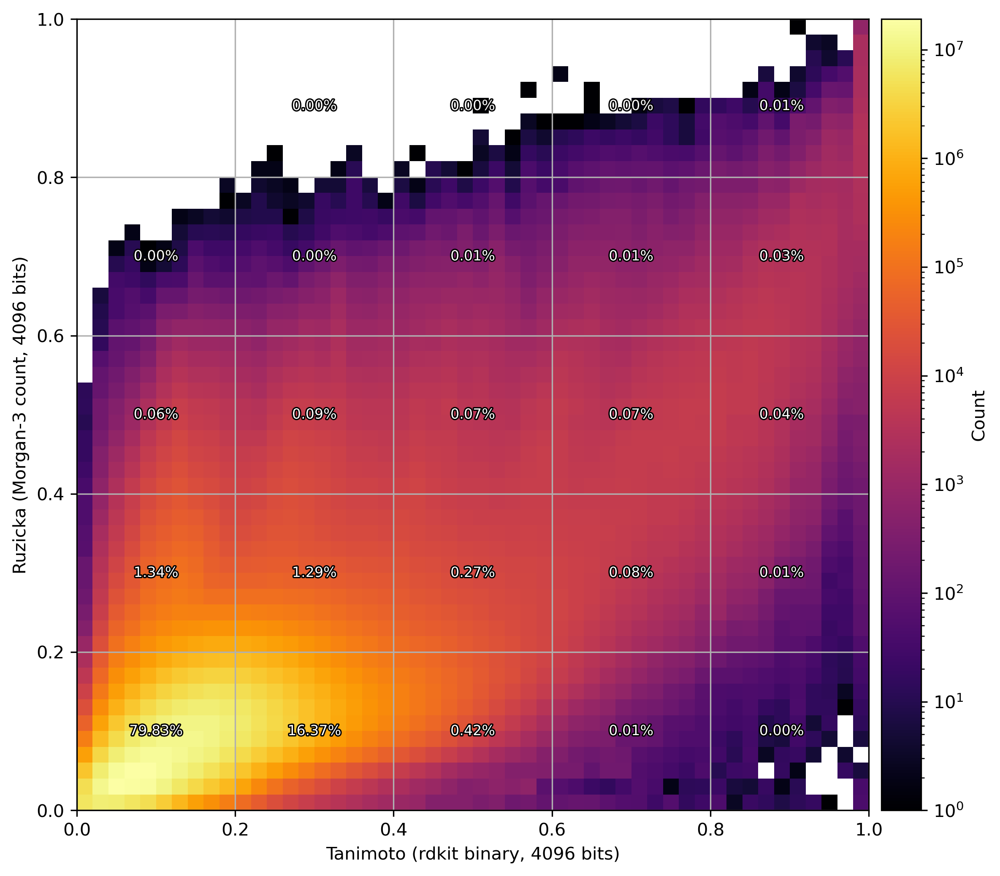

In [89]:
heatmap_comparison(
    similarities_rdkit,
    similarities_morgan3_count,
    f"Tanimoto (rdkit binary, {NBITS} bits)",
    f"Ruzicka (Morgan-3 count, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_tanimoto_rdkit_vs_ruzicka_morgan3.png"
)

## Tanimoto (Morgan-3) vs Ruzicka (Morgan-3)

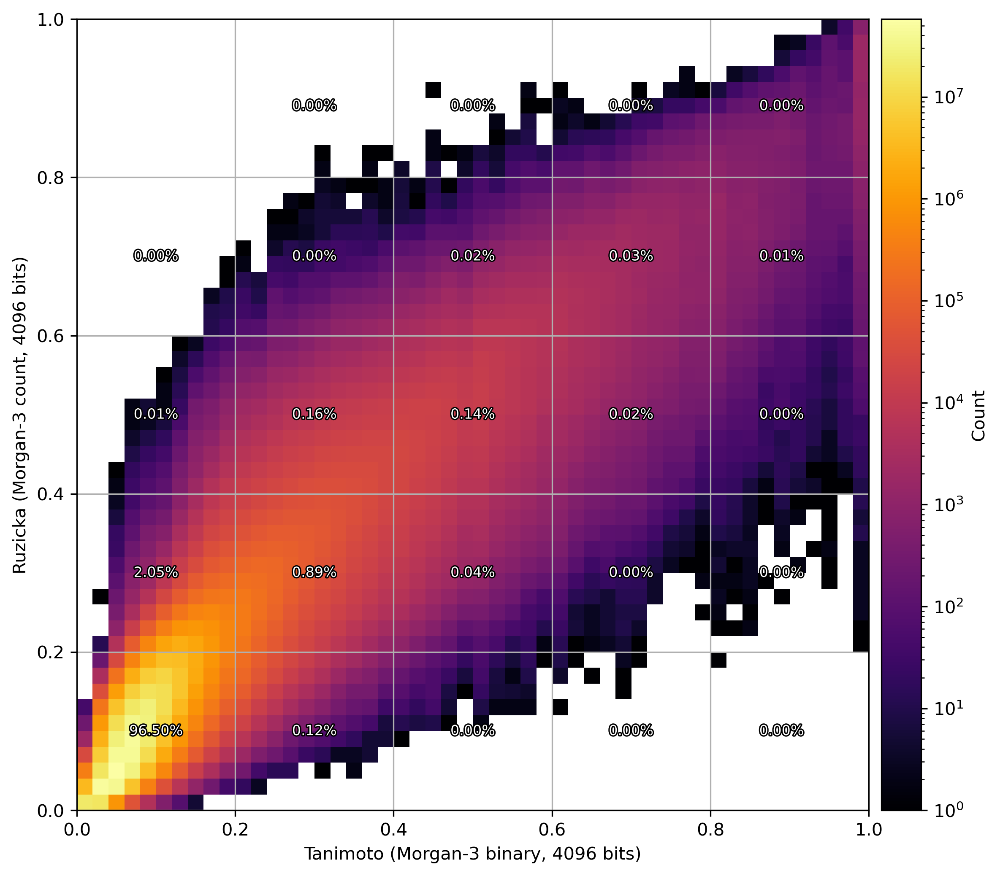

In [15]:
NBITS = 4096

heatmap_comparison(
    similarities_morgan3,
    similarities_morgan3_count,
    f"Tanimoto (Morgan-3 binary, {NBITS} bits)",
    f"Ruzicka (Morgan-3 count, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_tanimoto_morgan3_vs_ruzicka_morgan3.png"
)

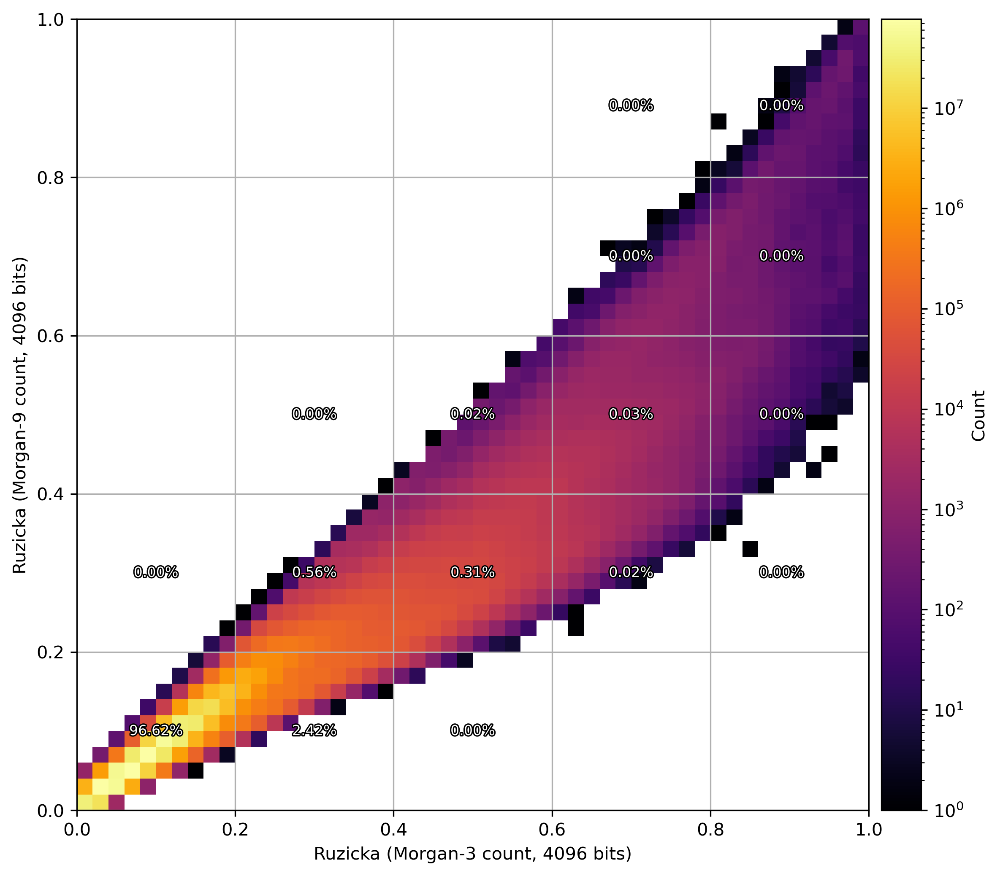

In [16]:
heatmap_comparison(
    similarities_morgan3_count,
    similarities_morgan9_count,
    f"Ruzicka (Morgan-3 count, {NBITS} bits)",
    f"Ruzicka (Morgan-9 count, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_ruzicka_morgan3_vs_ruzicka_morgan9.png"
)

## Compare to MAP4

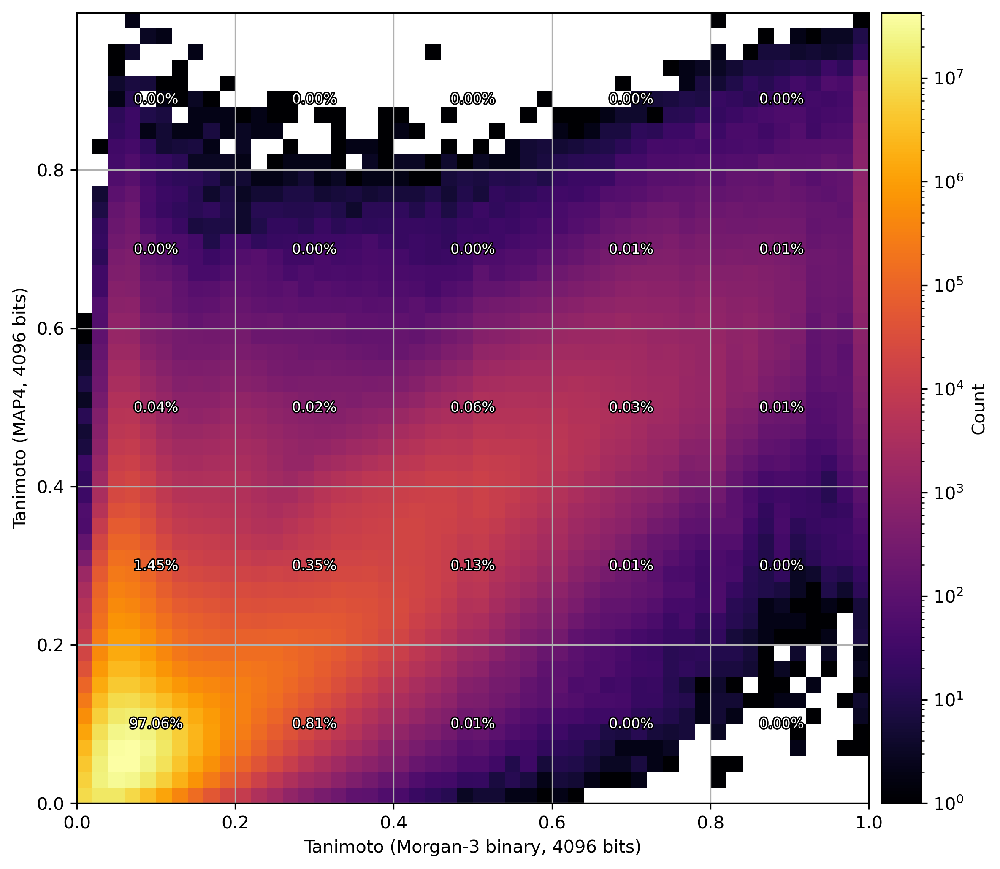

In [20]:
heatmap_comparison(
    similarities_morgan3,
    similarities_map4,
    f"Tanimoto (Morgan-3 binary, {NBITS} bits)",
    f"Tanimoto (MAP4, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_tanimoto_morgan3_vs_tanimoto_map4.png"
)

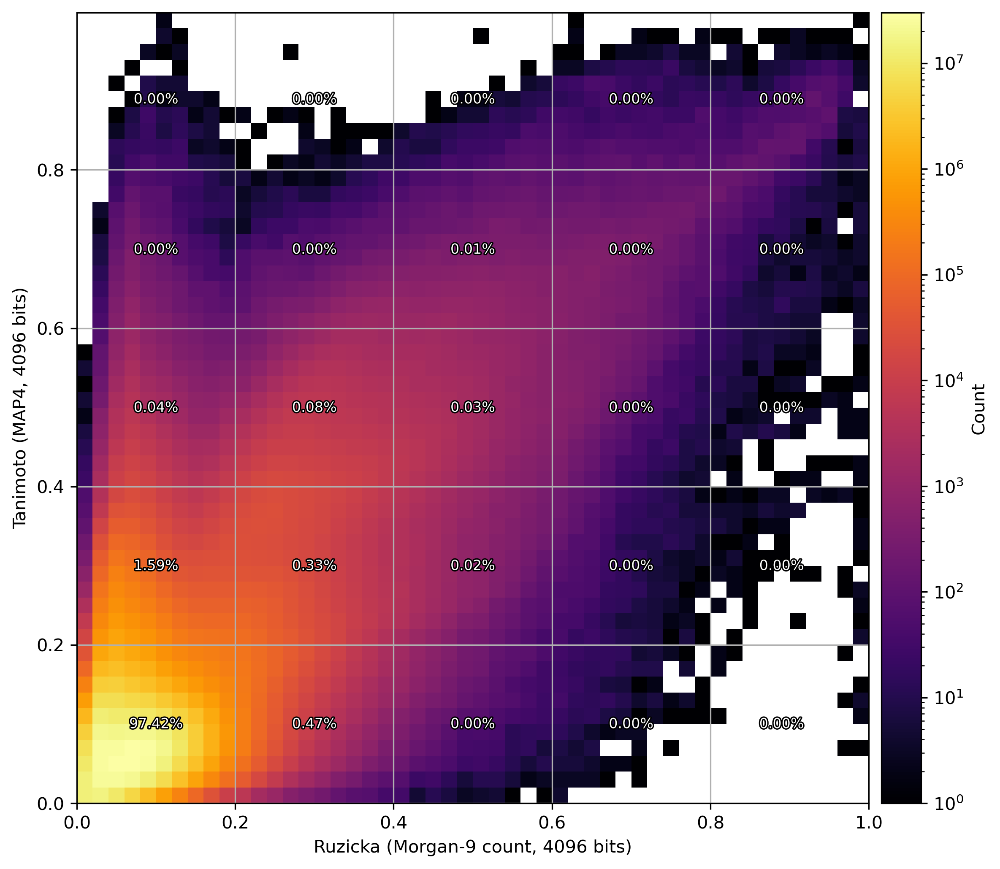

In [21]:
heatmap_comparison(
    similarities_morgan9_count,
    similarities_map4,
    f"Ruzicka (Morgan-9 count, {NBITS} bits)",
    f"Tanimoto (MAP4, {NBITS} bits)",
    colormap="inferno",
    bins=50,
    filename="heatmap_ruzicka_morgan9_vs_tanimoto_map4.png"
)